In [ ]:
#https://towardsdatascience.com/pycaret-review-65cbe2f663bb
#https://towardsdatascience.com/pycaret-2-3-6-is-here-learn-whats-new-1479c8bab8ad
#https://medium.com/@data.science.enthusiast/explain-any-machine-learning-model-in-python-shap-4caf1c343f3


In [7]:
#!pip install shap
#!pip install mlflow 
#!pip install pycaret  

#!pip install 'pycaret[full]'
#!pip install mlflow --upgrade


In [2]:
import pycaret.classification as pyc
import mlflow


In [2]:
import pandas as pd
df = pd.read_csv('../diagnostico-ofertas-if/merge2018-tratado.csv')
df.head()

df['Situação no Curso'].value_counts()

Matriculado                        22478
Evasão                             11109
Concluído                           6742
Cancelado                           3563
Formado                              630
Transferido Interno                  539
Trancado Voluntariamente             330
Jubilado                             329
Matrícula Vínculo Institucional      295
Transferido Externo                  282
Cancelamento Compulsório             255
Trancado                              58
Cancelamento por Duplicidade          44
Cancelamento por Desligamento         31
Integralizado Fase Escolar             6
Intercâmbio                            5
Name: Situação no Curso, dtype: int64

In [3]:
# Criando o novo atributo 'class'
df['class'] = df['Situação no Curso'].apply(lambda x: 1 if x in ['Evasão'] else 0)

# Removendo instâncias onde o novo atributo 'class' é NaN
df = df[df['class'].notna()]

#remove sitaucao no curso
del df['Situação no Curso']
del df['Situação no Período']
del df['Ano de Conclusão']
del df['Data de Conclusão de Curso']
del df['Data do Último Procedimento']
del df['Frequência no Período']
del df['I.R.A.']
del df['Percentual de Progresso']
del df['ano_ultimo_procedimento']


# Verificando as primeiras linhas do DataFrame após as alterações
df.head()

,Unnamed: 0,Ano Letivo de Previsão de Conclusão,Ano de Ingresso,Campus,Cota MEC,Cota Sistec,Código Curso,Deficiência,Descrição do Curso,Estado Civil,...,BENEFICIARIO PROGRAMA SOCIAL,TIPO SERVICO SAUDE,FREQUENCIA ACESSO INTERNET,LOCAL ACESSO INTERNET,QUANTIDADE COMPUTADORES,QUANTIDADE NOTEBOOKS,QUANTIDADE NETBOOKS,QUANTIDADE SMARTPHONES,curso,class
0,0,2024,2023,AP,NaN,NaN,8079,NaN,"Técnico de Nivel Médio em Agropecuária, na For...",Solteiro,...,NaN,Sistema Único de Saúde - SUS,Diariamente,NaN,0.0,0.0,0.0,1.0,Técnico em Agropecuária,0
1,1,2021,2018,AP,NaN,NaN,8401,NaN,"Técnico de Nivel Médio em Informática, na Form...",Solteiro,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Técnico em Informática,0
2,2,2020,2018,AP,NaN,NaN,8407,NaN,Técnico de Nível Médio em Manutenção e Suporte...,Solteiro,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Técnico em Manutenção e Suporte em Informática,1
3,4,2022,2020,AP,NaN,NaN,8428,NaN,"Técnico de Nível Médio em Química, na Forma Su...",Casado,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Técnico em Química,1
4,5,2022,2019,AP,NaN,NaN,8427,NaN,"Técnico de Nível Médio em Biocombustíveis, na ...",Solteiro,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Técnico em Biocombustíveis,0


In [4]:
data = df.sample(frac=0.80, random_state=42)
data_unseen = df.drop(data.index)
data.reset_index(inplace=True, drop=True)
data_unseen.reset_index(inplace=True, drop=True)

print('Data for Modeling: ' + str(data.shape))
print('Unseen Data For Predictions: ' + str(data_unseen.shape))

print(data['class'].value_counts())
print(data_unseen['class'].value_counts())

Data for Modeling: (37357, 164)
Unseen Data For Predictions: (9339, 164)
0    28422
1     8935
Name: class, dtype: int64
0    7165
1    2174
Name: class, dtype: int64


In [5]:
# If you're using Databricks set the experiment name to the full path:
# EXPERIMENT_NAME = "/Users/username@domain/folder..."
EXPERIMENT_NAME = "exp-shap"
mlflow.set_experiment(EXPERIMENT_NAME)


# it even has a default train size of 70%
clf1 = pyc.setup(
  data,
  target="class",
  normalize=True,
  log_experiment=True,
  feature_selection_method="boruta",
  experiment_name=EXPERIMENT_NAME)

# if you're using databricks and you can't interact with the notebook
# you'll need to set silent=True and check the columns manually

,Description,Value
0,Session id,1181
1,Target,class
2,Target type,Binary
3,Original data shape,"(37357, 164)"
4,Transformed data shape,"(37357, 700)"
5,Transformed train set shape,"(26149, 700)"
6,Transformed test set shape,"(11208, 700)"
7,Ordinal features,23
8,Numeric features,26
9,Categorical features,137


In [7]:
# generate EDA
pyc.eda()

Imported v0.1.730. After importing autoviz, execute '%matplotlib inline' to display charts inline.
    AV = AutoViz_Class()
    dfte = AV.AutoViz(filename, sep=',', depVar='', dfte=None, header=0, verbose=1, lowess=False,
               chart_format='svg',max_rows_analyzed=150000,max_cols_analyzed=30, save_plot_dir=None)
Shape of your Data Set loaded: (37357, 700)
#######################################################################################
######################## C L A S S I F Y I N G  V A R I A B L E S  ####################
#######################################################################################
Classifying variables in data set...
    699 Predictors classified...
        4 variable(s) removed since they were ID or low-information variables
        List of variables removed: ['Superdotação_Altas habilidades/Superdotação', 'Carga Horária Eletiva Pendente_Não', 'PRATICA_TIPO_4_Atividade profissional efetiva', 'ALUNO EXCLUSIVO REDE PUBLICA_Não']

##############

Row
    [0] WidgetBox
        [0] Select(name='y', options=['ENSINO FUNDAMENTAL CONCL...], value='ENSINO FUNDAMENTAL C...)
    [1] ParamFunction(function, _pane=HoloViews)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['ENSINO FUNDAMENTAL CONCL...], value='ENSINO FUNDAMENTAL C...)
        [1] Select(name='Y-Axis', options=['ENSINO FUNDAMENTAL CONCL...], value='RENDA BRUTA FAMILIAR')
        [2] Select(name='Color', options=['None', 'class'], value='None')
    [1] ParamFunction(function, _pane=HoloViews)

Column
    [0] Row
        [0] HoloViews(DynamicMap, height=400, sizing_mode='fixed', width=600)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['Prática Profissional Pen...], value='Prática Profissional P..., width=250)
            [1] VSpacer()

Column
    [0] Row
        [0] HoloViews(DynamicMap, height=400, sizing_mode='fixed', width=600)
        [1] Column
            [0] WidgetBox
                [0] Select(margin=(20, 20, 20, 20), options=['RENDA BRUTA FAMILIAR', ...], value='RENDA BRUTA FAMILIAR', width=250)
            [1] VSpacer()

HoloViews(DynamicMap)

HoloViews(Layout)

No date vars could be found in data set


HoloViews(Overlay, height=800, sizing_mode='fixed', width=1200)

Row
    [0] WidgetBox
        [0] Select(name='X-Axis', options=['Prática Profissional Pen...], value='Prática Profissional P...)
        [1] Select(name='Y-Axis', options=['ENSINO FUNDAMENTAL CONCL...], value='ENSINO FUNDAMENTAL C...)
    [1] ParamFunction(function, _pane=HoloViews)

Time to run AutoViz (in seconds) = 28


In [8]:
top5_models = pyc.compare_models(
  n_select = 5,
  sort="f1")

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,08:18:38
Status,. . . . . . . . . . . . . . . . . .,Loading Dependencies
Estimator,. . . . . . . . . . . . . . . . . .,Compiling Library


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.8329,0.8780,0.8186,0.7243,0.7685,0.7237,0.7262,0.9930
catboost,CatBoost Classifier,0.8327,0.8782,0.8105,0.7280,0.7669,0.7221,0.7240,3.3380
xgboost,Extreme Gradient Boosting,0.8306,0.8764,0.8028,0.7258,0.7622,0.7160,0.7177,6.1400
gbc,Gradient Boosting Classifier,0.8269,0.8755,0.8060,0.7131,0.7566,0.7078,0.7102,2.2710
rf,Random Forest Classifier,0.8243,0.8741,0.7868,0.7154,0.7493,0.6989,0.7004,0.9270
lda,Linear Discriminant Analysis,0.8205,0.8688,0.8239,0.6868,0.7490,0.6957,0.7011,1.0510
ridge,Ridge Classifier,0.8205,0.0000,0.8025,0.6967,0.7457,0.6926,0.6958,0.6290
ada,Ada Boost Classifier,0.8209,0.8724,0.7913,0.7032,0.7445,0.6918,0.6940,1.0290
lr,Logistic Regression,0.8206,0.8697,0.7934,0.7014,0.7444,0.6915,0.6939,0.7660
et,Extra Trees Classifier,0.8205,0.8707,0.7691,0.7134,0.7401,0.6873,0.6882,1.0860


Processing:   0%|          | 0/73 [00:00<?, ?it/s]

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9254,0.9733,0.9206,0.7984,0.8552,0.8053,0.8090


,Samples,Accuracy,AUC,Recall,Precision,F1,Kappa,MCC,Selection Rate
Etnia/Raça,,,,,,,,,
Amarela,72,0.916667,0.925926,0.944444,0.772727,0.85,0.793103,0.800757,0.305556
Branca,3530,0.932011,0.925915,0.915144,0.800228,0.853837,0.809799,0.812893,0.248159
Indígena,34,0.852941,0.854497,0.857143,0.6,0.705882,0.611872,0.62917,0.294118
Não declarado,374,0.92246,0.919602,0.912281,0.845528,0.877637,0.821005,0.822275,0.328877
Parda,6280,0.926274,0.925069,0.922724,0.803307,0.858884,0.80931,0.81287,0.279299
Preta,899,0.902113,0.910905,0.930041,0.760943,0.837037,0.76808,0.775979,0.330367
NaN,19,0.736842,0.762821,0.833333,0.555556,0.666667,0.463277,0.489345,0.473684


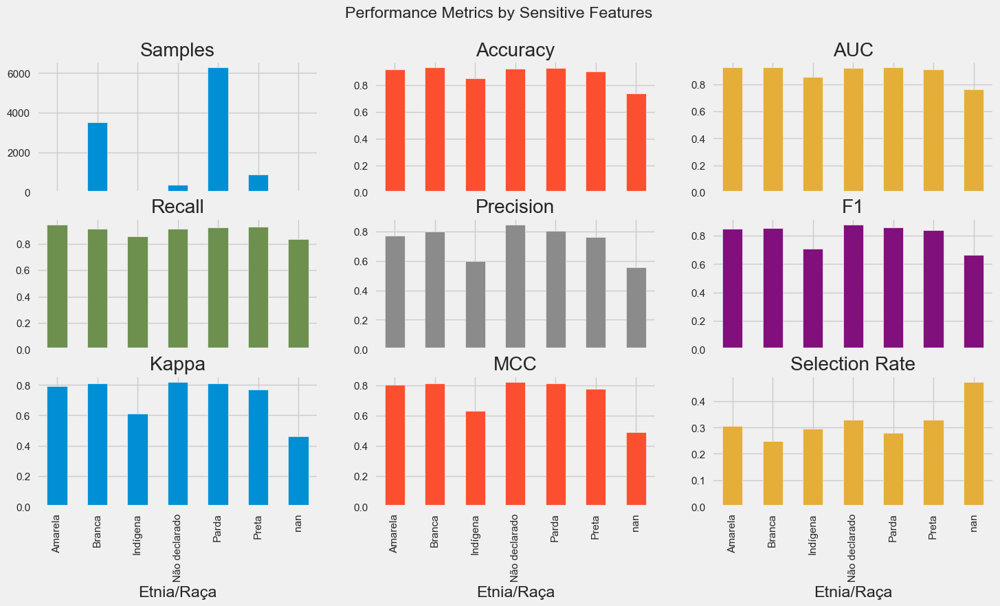

In [9]:
# check fairness
pyc.check_fairness(top5_models[0], sensitive_features = ['Etnia/Raça'])

In [10]:
# generate dashboard
pyc.dashboard(top5_models[0])

Note: model_output=='probability'. For LGBMClassifier shap values normally get calculated against X_background, but paramater X_background=None, so using X instead
Generating self.shap_explainer = shap.TreeExplainer(model, X, model_output='probability', feature_perturbation='interventional')...
Note: Shap interaction values will not be available. If shap values in probability space are not necessary you can pass model_output='logodds' to get shap values in logodds without the need for a background dataset and also working shap interaction values...
Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is running...
For this type of model and model_output interactions don't work, so setting shap_interaction=False...
The explainer object has no decision_trees property. so setting decision_trees=False...
Generating layout...
Calculating shap values...


 99%|===================| 11060/11208 [00:24<00:00]        

Calculating prediction probabilities...
Calculating metrics...
Calculating confusion matrices...
Calculating classification_dfs...
Calculating roc auc curves...
Calculating pr auc curves...
Calculating liftcurve_dfs...
Calculating dependencies...
Calculating permutation importances (if slow, try setting n_jobs parameter)...
Calculating pred_percentiles...
Calculating predictions...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...
Starting ExplainerDashboard on http://192.168.1.26:8050


In [11]:
# optimize threshold
pyc.optimize_threshold(top5_models[0])

optimization loop finished successfully. Best threshold: 0.46875 with Accuracy=0.8331


CustomProbabilityThresholdClassifier(boosting_type='gbdt', class_weight=None,
                                     classifier=LGBMClassifier(boosting_type='gbdt',
                                                               class_weight=None,
                                                               colsample_bytree=1.0,
                                                               importance_type='split',
                                                               learning_rate=0.1,
                                                               max_depth=-1,
                                                               min_child_samples=20,
                                                               min_child_weight=0.001,
                                                               min_split_gain=0.0,
                                                               n_estimators=100,
                                                               n_jobs=-1,
                                                               num_leaves=31,
                                                               objective=None,
                                                               random_state=1...
                                                               subsample_for_bin=200000,
                                                               subsample_freq=0),
                                     colsample_bytree=1.0,
                                     importance_type='split', learning_rate=0.1,
                                     max_depth=-1, min_child_samples=20,
                                     min_child_weight=0.001, min_split_gain=0.0,
                                     n_estimators=100, n_jobs=-1, num_leaves=31,
                                     objective=None,
                                     probability_threshold=0.46875,
                                     random_state=1181, reg_alpha=0.0,
                                     reg_lambda=0.0, subsample=1.0,
                                     subsample_for_bin=200000,
                                     subsample_freq=0)

Feature Importance do Modelo (LGBMClassifier)


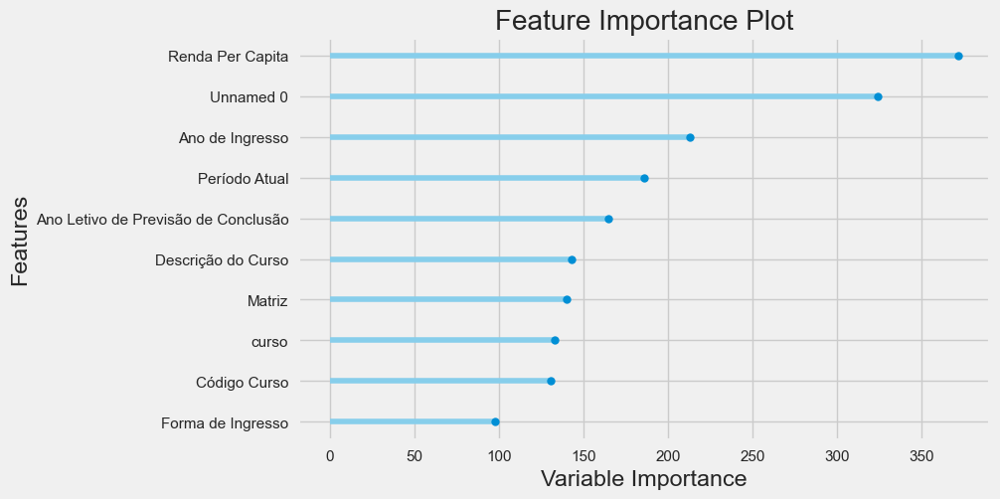

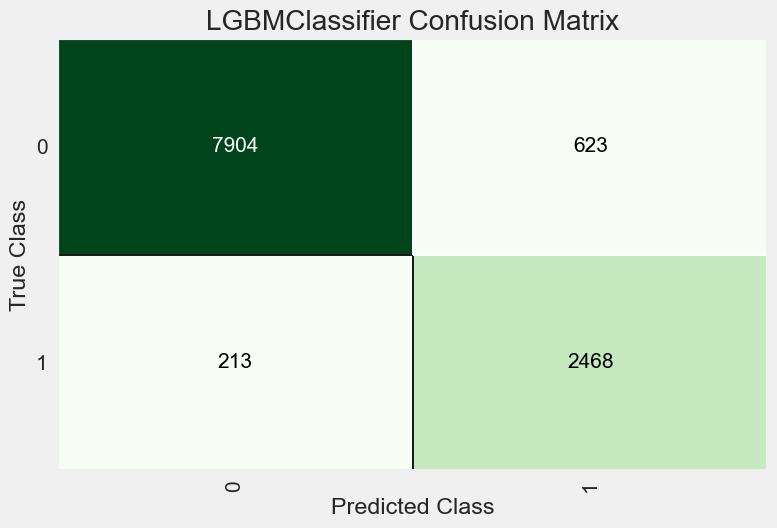

Feature Importance do Modelo (CatBoostClassifier)


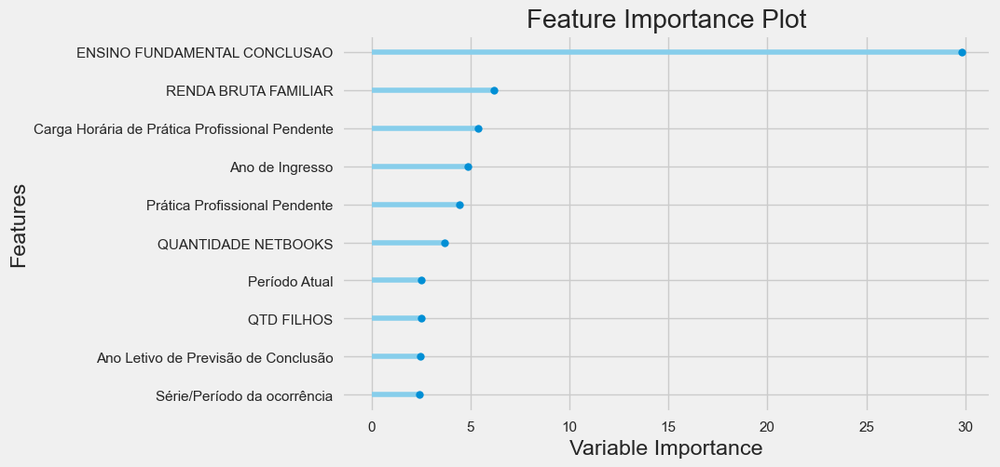

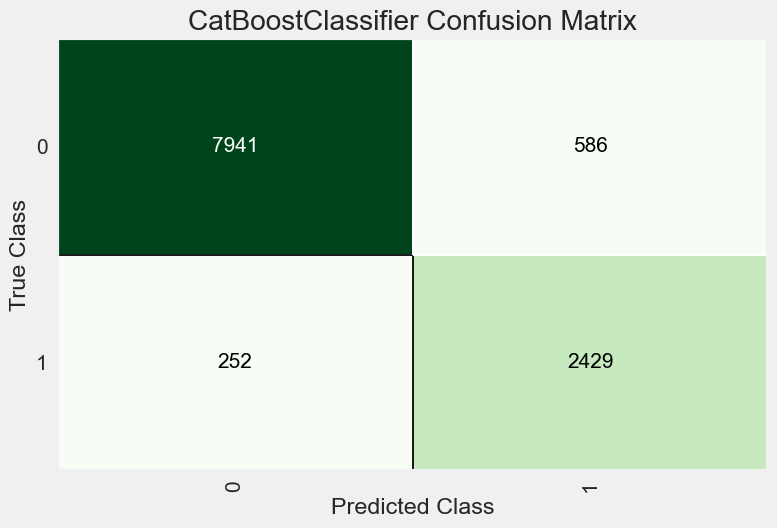

Feature Importance do Modelo (XGBClassifier)


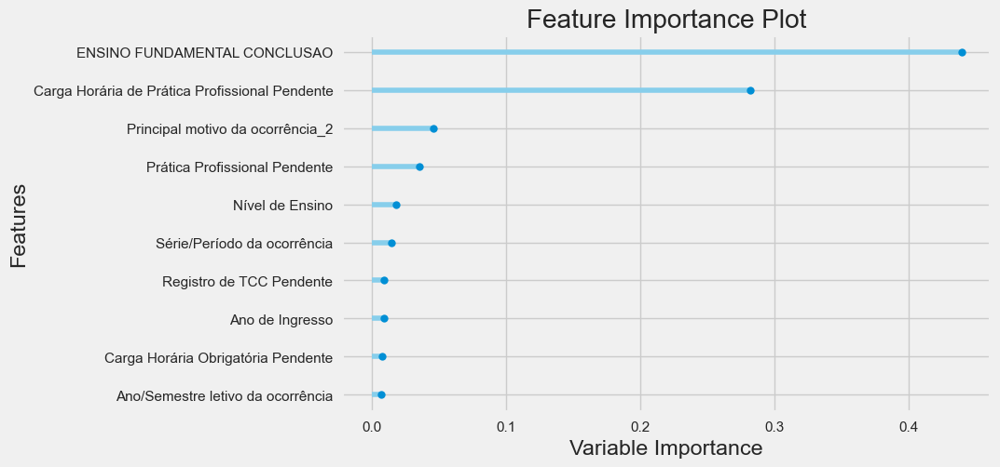

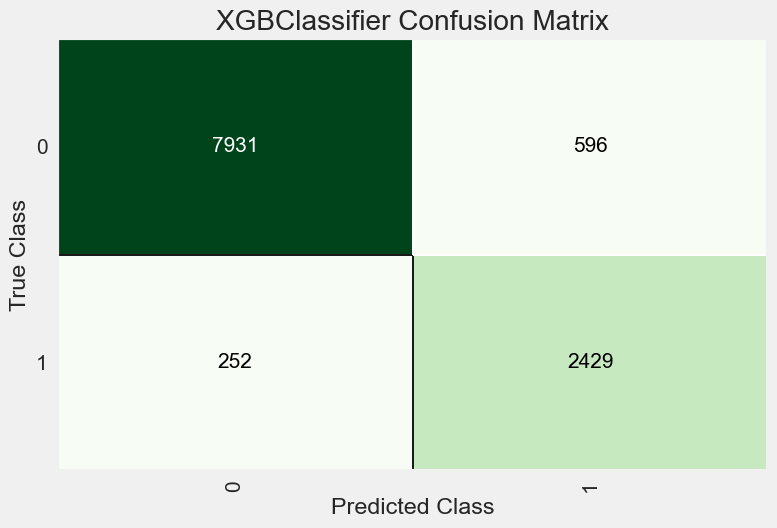

Feature Importance do Modelo (GradientBoostingClassifier)


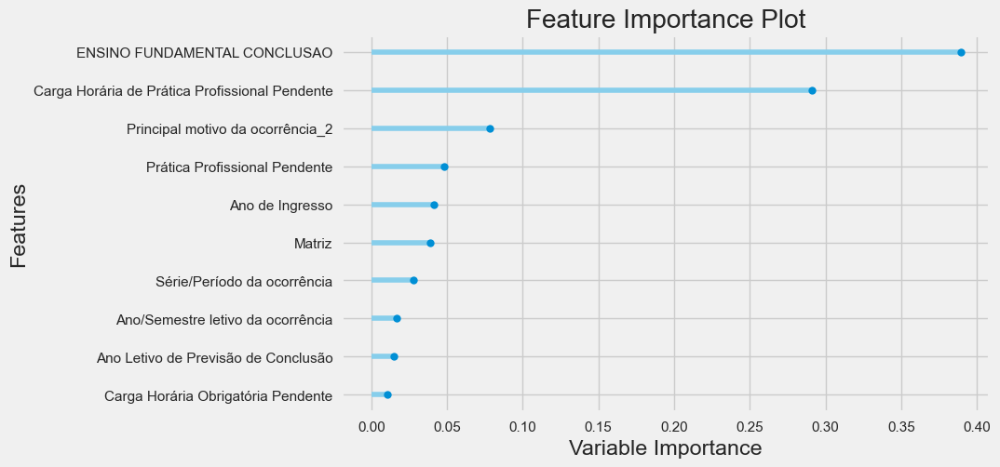

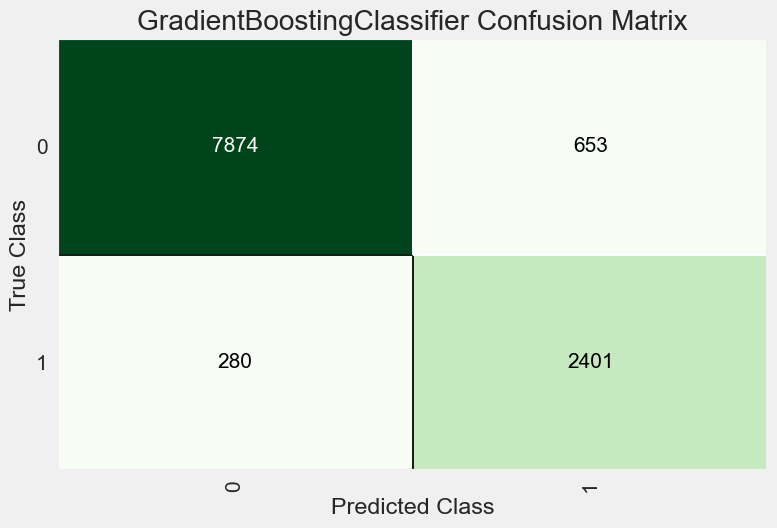

Feature Importance do Modelo (RandomForestClassifier)


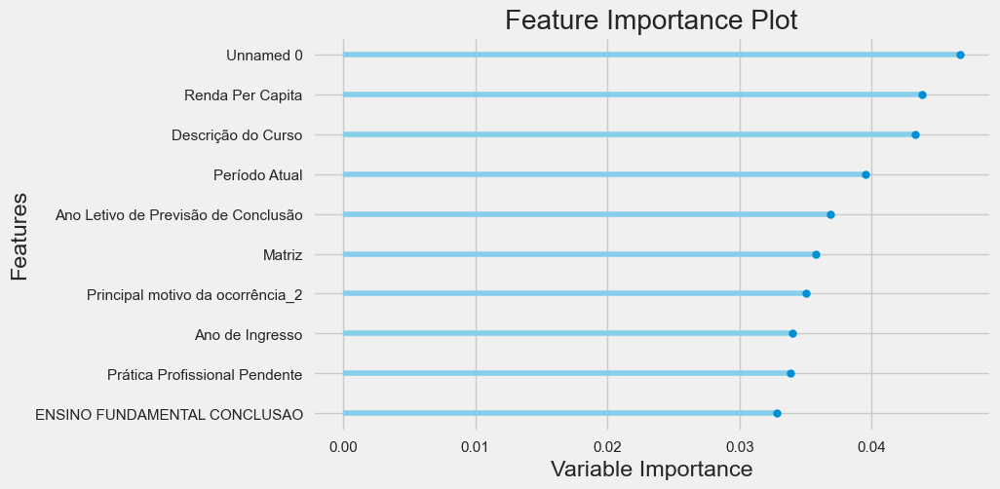

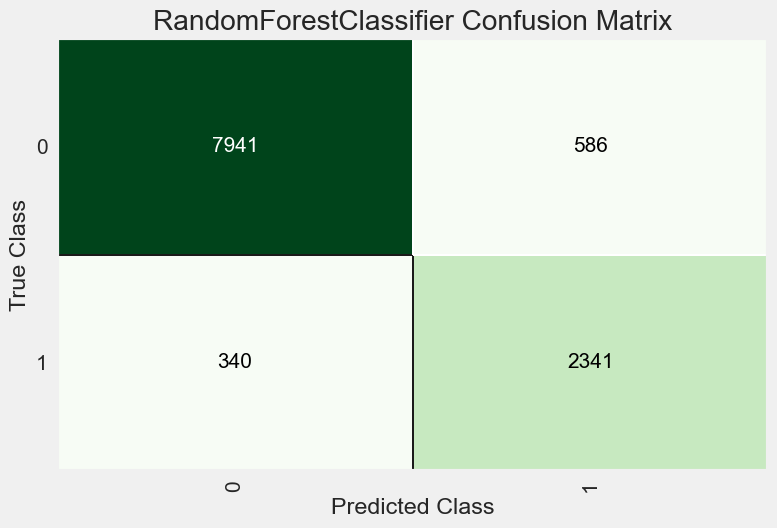

In [12]:
import matplotlib.pyplot as plt

for model in top5_models:
  #plt.figure(figsize=(12, 6))
  
  print(f"Feature Importance do Modelo ({model.__class__.__name__})")
  pyc.plot_model(model, plot='feature')#, plot_kwargs = {'title' : "teste"})
  pyc.plot_model(model, plot='confusion_matrix')#, plot_kwargs = {'percent' : True})

In [13]:
#tunning os hiper parametros (demora bastante)
tuned_top5 = [
  pyc.tune_model(
    i,
    n_iter=100,
    optimize="f1",
    choose_better=True,
    early_stopping=True)
  for i in top5_models
  ]

Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 100 candidates, totalling 1000 fits
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] bagging_fraction is set=0.8, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8
[LightGBM] [Info] Number of positive: 5629, number of negative: 17906
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing wa

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8218,0.9576,0.2576,0.9877,0.4086,0.3437,0.4526
1,0.8268,0.9582,0.2768,0.9943,0.4330,0.3672,0.4728
2,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
3,0.8241,0.9575,0.2656,0.9940,0.4192,0.3541,0.4624
4,0.8161,0.9492,0.2352,0.9800,0.3794,0.3161,0.4286
5,0.8172,0.9546,0.2396,0.9868,0.3856,0.3222,0.4352
6,0.8272,0.9545,0.2812,0.9888,0.4378,0.3712,0.4746
7,0.8218,0.9538,0.2652,0.9651,0.4160,0.3488,0.4513
8,0.8115,0.9589,0.2125,1.0000,0.3505,0.2910,0.4126


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 100 candidates, totalling 1000 fits
Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8937,0.9653,0.9952,0.6934,0.8173,0.7457,0.7699
1,0.8899,0.9660,0.9952,0.6858,0.8120,0.7378,0.7634
2,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
3,0.8902,0.9699,0.9984,0.6857,0.8130,0.7391,0.7652
4,0.8822,0.9618,0.9920,0.6717,0.8010,0.7217,0.7494
5,0.8803,0.9654,0.9952,0.6677,0.7992,0.7186,0.7476
6,0.8837,0.9603,0.9968,0.6739,0.8041,0.7258,0.7539
7,0.8933,0.9665,0.9968,0.6926,0.8173,0.7454,0.7700
8,0.8964,0.9677,1.0000,0.6979,0.8221,0.7522,0.7764


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 100 candidates, totalling 1000 fits
Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.7610,0.9621,0.0000,0.0000,0.0000,0.0000,0.0000
1,0.7610,0.9656,0.0000,0.0000,0.0000,0.0000,0.0000
2,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
3,0.7610,0.9650,0.0000,0.0000,0.0000,0.0000,0.0000
4,0.7610,0.9568,0.0000,0.0000,0.0000,0.0000,0.0000
5,0.7606,0.9569,0.0000,0.0000,0.0000,0.0000,0.0000
6,0.7606,0.9583,0.0000,0.0000,0.0000,0.0000,0.0000
7,0.7606,0.9619,0.0000,0.0000,0.0000,0.0000,0.0000
8,0.7606,0.9634,0.0000,0.0000,0.0000,0.0000,0.0000


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 100 candidates, totalling 1000 fits
Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.8099,0.9514,0.9984,0.5571,0.7152,0.5891,0.6457
1,0.7166,0.9434,1.0000,0.4575,0.6278,0.4462,0.5359
2,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
3,0.8015,0.9526,0.9952,0.5466,0.7056,0.5742,0.6330
4,0.6967,0.9445,1.0000,0.4408,0.6118,0.4191,0.5149
5,0.7017,0.9549,1.0000,0.4452,0.6161,0.4260,0.5202
6,0.7013,0.9458,0.9984,0.4448,0.6155,0.4250,0.5188
7,0.7174,0.9493,1.0000,0.4586,0.6288,0.4475,0.5369
8,0.8145,0.9453,1.0000,0.5635,0.7208,0.5975,0.6527


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 100 candidates, totalling 1000 fits
Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


In [24]:
for model in tuned_top5:
    print(model)

len(tuned_top5)

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=1181, reg_alpha=0.0, reg_lambda=0.0, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)
XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None

5

In [14]:
blended = pyc.blend_models(
  tuned_top5,
  #top5_models,
  choose_better=True,
  optimize="f1")

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
Fold,,,,,,,
0,0.9231,0.9749,0.9072,0.7986,0.8494,0.7981,0.8010
1,0.9270,0.9781,0.9008,0.8136,0.8550,0.8063,0.8082
2,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000
3,0.9247,0.9780,0.8928,0.8110,0.8500,0.7998,0.8015
4,0.9228,0.9731,0.9184,0.7917,0.8504,0.7987,0.8027
5,0.9208,0.9749,0.8866,0.8032,0.8428,0.7901,0.7918
6,0.9197,0.9753,0.9058,0.7897,0.8437,0.7901,0.7934
7,0.9262,0.9756,0.9121,0.8054,0.8554,0.8061,0.8090
8,0.9338,0.9790,0.9089,0.8307,0.8680,0.8240,0.8255


Processing:   0%|          | 0/6 [00:00<?, ?it/s]

Original model was better than the blended model, hence it will be returned. NOTE: The display metrics are for the blended model (not the original one).


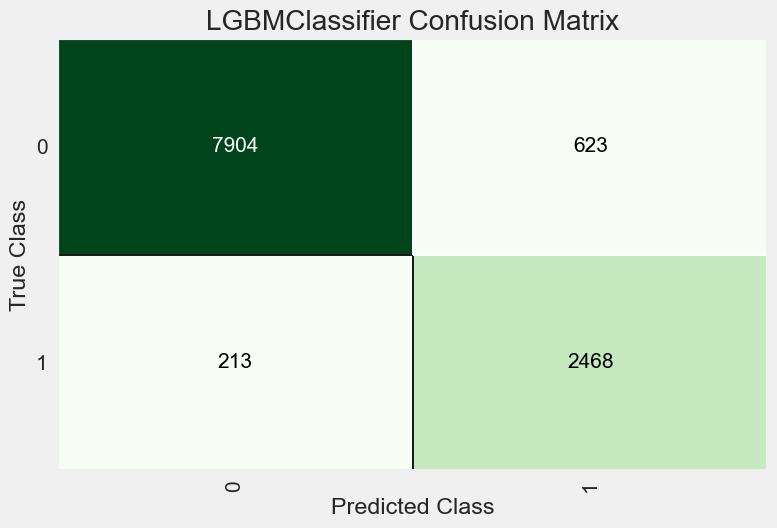

In [15]:
#import matplotlib.pyplot as plt
#%matplotlib inline
#plt.figure(figsize=(12, 6))

pyc.plot_model(blended, plot='confusion_matrix')

#plt.show()


In [16]:
# don't forget to run pyc.finalize_model(blended) to train on whole dataset
pred_df = pyc.predict_model(blended, data_unseen)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9252,0.9743,0.9131,0.7956,0.8503,0.8007,0.8041


In [17]:
# with new Label column at the end
pred_df.head()

,Unnamed: 0,Ano Letivo de Previsão de Conclusão,Ano de Ingresso,Campus,Cota MEC,Cota Sistec,Código Curso,Deficiência,Descrição do Curso,Estado Civil,...,FREQUENCIA ACESSO INTERNET,LOCAL ACESSO INTERNET,QUANTIDADE COMPUTADORES,QUANTIDADE NOTEBOOKS,QUANTIDADE NETBOOKS,QUANTIDADE SMARTPHONES,curso,class,prediction_label,prediction_score
0,2,2020,2018,AP,NaN,NaN,8407,NaN,"Técnico de Nível Médio em Manutenção e Suporte em Informática, na Forma Subsequente [2014] - Campus Apodi",Solteiro,...,NaN,NaN,NaN,NaN,NaN,NaN,Técnico em Manutenção e Suporte em Informática,1,1,0.7305
1,12,2022,2018,AP,NaN,NaN,8413,NaN,Licenciatura em Química (2012) - Campus Apodi,Solteiro,...,NaN,NaN,NaN,NaN,NaN,NaN,Licenciatura em Química,0,0,0.8738
2,13,2020,2019,AP,NaN,NaN,8079,NaN,"Técnico de Nivel Médio em Agropecuária, na Forma Subsequente [2012] - Campus Apodi",Solteiro,...,NaN,NaN,NaN,NaN,NaN,NaN,Técnico em Agropecuária,0,0,0.9978
3,19,2025,2022,AP,NaN,NaN,8026,NaN,"Técnico de Nivel Médio em Agropecuária, na Forma Integrada (2015) - Campus Apodi",Solteiro,...,Diariamente,NaN,0.0,1.0,1.0,3.0,Técnico em Agropecuária,0,0,0.9999
4,23,2024,2023,AP,NaN,NaN,8079,NaN,"Técnico de Nivel Médio em Agropecuária, na Forma Subsequente [2012] - Campus Apodi",Solteiro,...,Diariamente,NaN,0.0,0.0,0.0,1.0,Técnico em Agropecuária,0,0,0.9999


In [21]:
blended

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=1181, reg_alpha=0.0, reg_lambda=0.0, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)

In [18]:
final_model = pyc.finalize_model(blended)
pyc.save_model(final_model, 'blended-model-pycaret-2023-09-16')

Transformation Pipeline and Model Successfully Saved


(Pipeline(memory=FastMemory(location=/var/folders/fh/g5fgxqq513n014czxdxy7sfc0000gn/T/joblib),
          steps=[('numerical_imputer',
                  TransformerWrapper(exclude=None,
                                     include=['Unnamed: 0',
                                              'Ano Letivo de Previsão de '
                                              'Conclusão',
                                              'Ano de Ingresso', 'Cota MEC',
                                              'Cota Sistec', 'Código Curso',
                                              'Período Atual',
                                              'Período Letivo de Integralização',
                                              'Período de Ingresso',
                                              'Renda Per Capita',
                                              'Ano...
                  LGBMClassifier(boosting_type='gbdt', class_weight=None,
                                 colsample_bytree=1.0, impo

In [19]:
saved_model = pyc.load_model('blended-model-pycaret-2023-09-16')


Transformation Pipeline and Model Successfully Loaded


In [20]:
saved_model

Pipeline(memory=FastMemory(location=/var/folders/fh/g5fgxqq513n014czxdxy7sfc0000gn/T/joblib),
         steps=[('numerical_imputer',
                 TransformerWrapper(exclude=None,
                                    include=['Unnamed: 0',
                                             'Ano Letivo de Previsão de '
                                             'Conclusão',
                                             'Ano de Ingresso', 'Cota MEC',
                                             'Cota Sistec', 'Código Curso',
                                             'Período Atual',
                                             'Período Letivo de Integralização',
                                             'Período de Ingresso',
                                             'Renda Per Capita',
                                             'Ano...
                 LGBMClassifier(boosting_type='gbdt', class_weight=None,
                                colsample_bytree=1.0, importance_type='split',
                                learning_rate=0.1, max_depth=-1,
                                min_child_samples=20, min_child_weight=0.001,
                                min_split_gain=0.0, n_estimators=100, n_jobs=-1,
                                num_leaves=31, objective=None,
                                random_state=1181, reg_alpha=0.0,
                                reg_lambda=0.0, subsample=1.0,
                                subsample_for_bin=200000, subsample_freq=0))],
         verbose=False)

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,Light Gradient Boosting Machine,0.9254,0.9733,0.9206,0.7984,0.8552,0.8053,0.8090


,Samples,Accuracy,AUC,Recall,Precision,F1,Kappa,MCC,Selection Rate
Etnia/Raça,,,,,,,,,
Amarela,72,0.916667,0.925926,0.944444,0.772727,0.85,0.793103,0.800757,0.305556
Branca,3530,0.932011,0.925915,0.915144,0.800228,0.853837,0.809799,0.812893,0.248159
Indígena,34,0.852941,0.854497,0.857143,0.6,0.705882,0.611872,0.62917,0.294118
Não declarado,374,0.92246,0.919602,0.912281,0.845528,0.877637,0.821005,0.822275,0.328877
Parda,6280,0.926274,0.925069,0.922724,0.803307,0.858884,0.80931,0.81287,0.279299
Preta,899,0.902113,0.910905,0.930041,0.760943,0.837037,0.76808,0.775979,0.330367
NaN,19,0.736842,0.762821,0.833333,0.555556,0.666667,0.463277,0.489345,0.473684


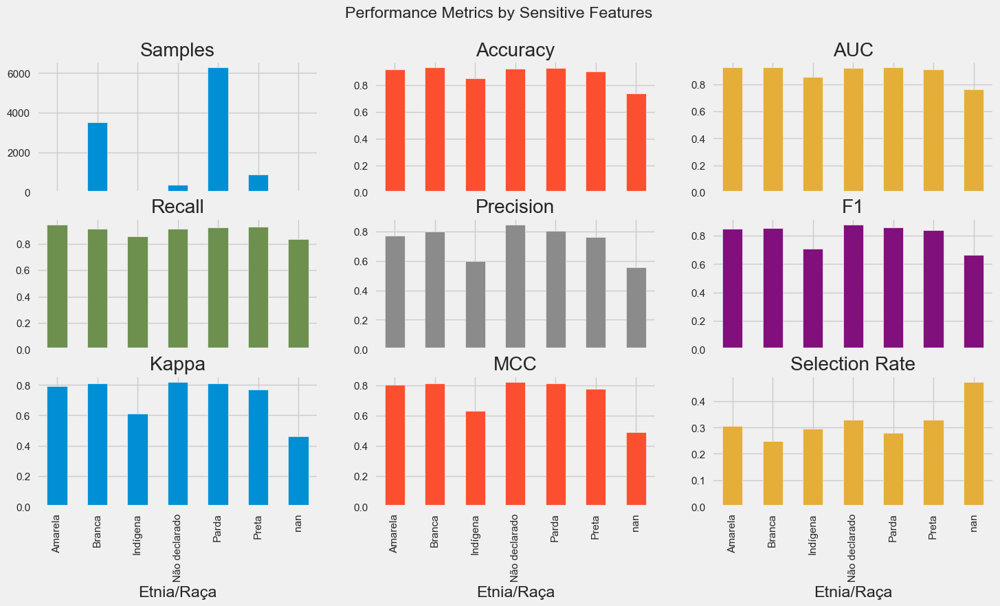

In [36]:
pyc.check_fairness(blended, sensitive_features = ['Etnia/Raça'])

In [38]:
# generate dashboard
pyc.dashboard(blended)

Note: model_output=='probability'. For LGBMClassifier shap values normally get calculated against X_background, but paramater X_background=None, so using X instead
Generating self.shap_explainer = shap.TreeExplainer(model, X, model_output='probability', feature_perturbation='interventional')...
Note: Shap interaction values will not be available. If shap values in probability space are not necessary you can pass model_output='logodds' to get shap values in logodds without the need for a background dataset and also working shap interaction values...
Building ExplainerDashboard..
Detected notebook environment, consider setting mode='external', mode='inline' or mode='jupyterlab' to keep the notebook interactive while the dashboard is running...
For this type of model and model_output interactions don't work, so setting shap_interaction=False...
The explainer object has no decision_trees property. so setting decision_trees=False...
Generating layout...
Calculating shap values...


 98%|===================| 10931/11208 [00:24<00:00]        

Calculating prediction probabilities...
Calculating metrics...
Calculating confusion matrices...
Calculating classification_dfs...
Calculating roc auc curves...
Calculating pr auc curves...
Calculating liftcurve_dfs...
Calculating dependencies...
Calculating permutation importances (if slow, try setting n_jobs parameter)...
Calculating pred_percentiles...
Calculating predictions...
Reminder: you can store the explainer (including calculated dependencies) with explainer.dump('explainer.joblib') and reload with e.g. ClassifierExplainer.from_file('explainer.joblib')
Registering callbacks...
Starting ExplainerDashboard on http://192.168.2.102:8050


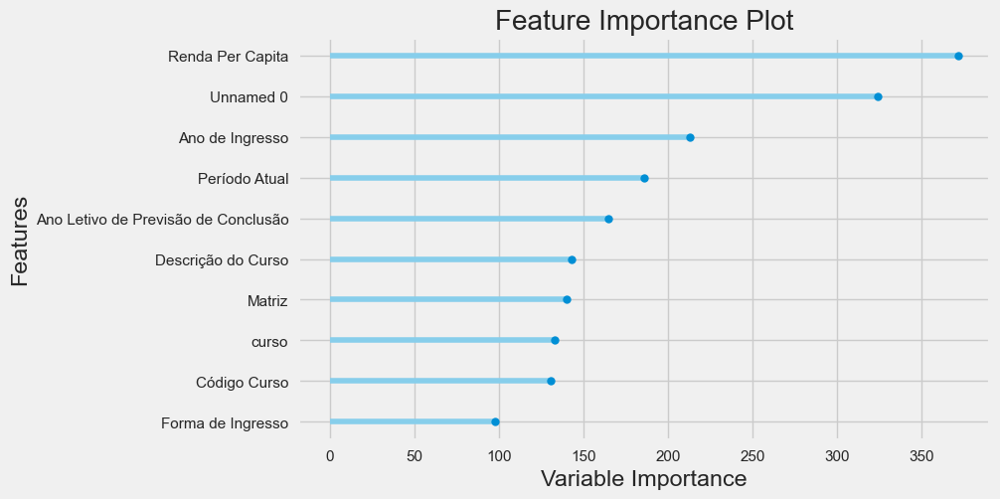

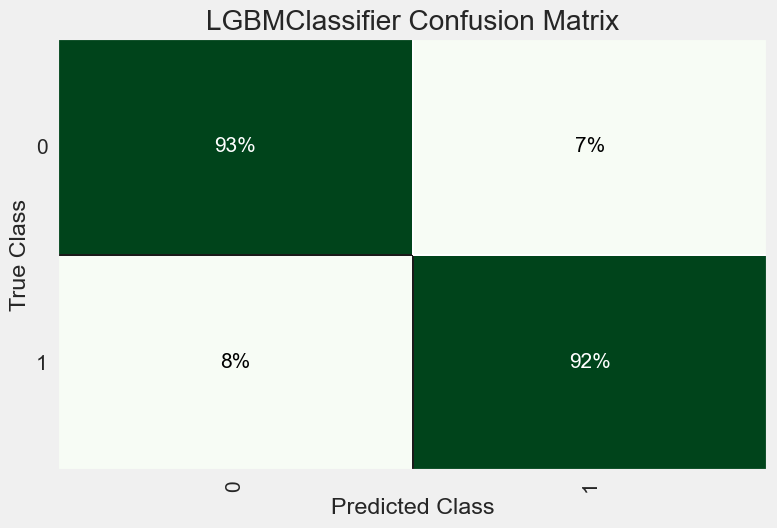

In [39]:
pyc.plot_model(blended, plot='feature')
pyc.plot_model(blended, plot='confusion_matrix', plot_kwargs = {'percent' : True})

In [25]:
#USANDO SHAP DIRETAMENTE
import shap 
shap.initjs() 

In [26]:
#dados de treino usando o pipeline salvo
train_pipe = saved_model[:-1].transform(data)

In [27]:
test_pipe = saved_model[:-1].transform(data_unseen)

In [29]:
#explainer = shap.Explainer(saved_model, train_pipe) 
#shap_values = explainer(test_pipe) 

explainer = shap.Explainer(tuned_top5[0], train_pipe) 
shap_values = explainer(test_pipe) 

#shap.plots.beeswarm(shap_values)

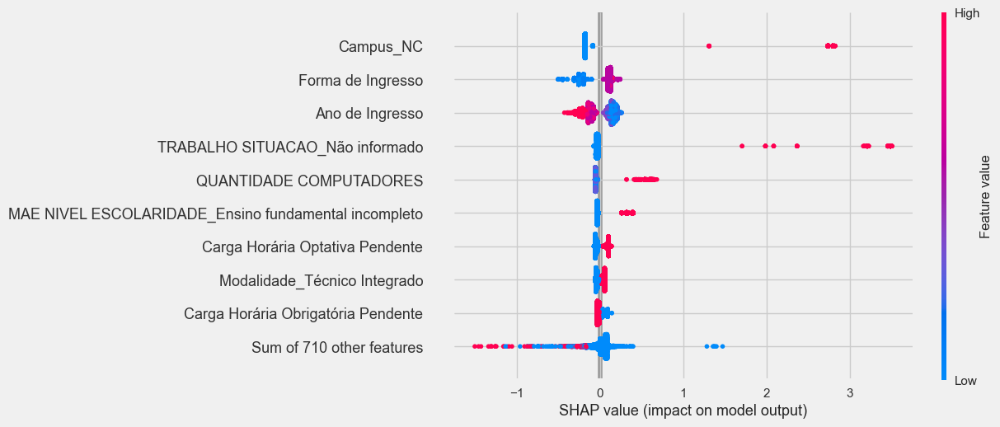

In [30]:
shap.plots.beeswarm(shap_values)

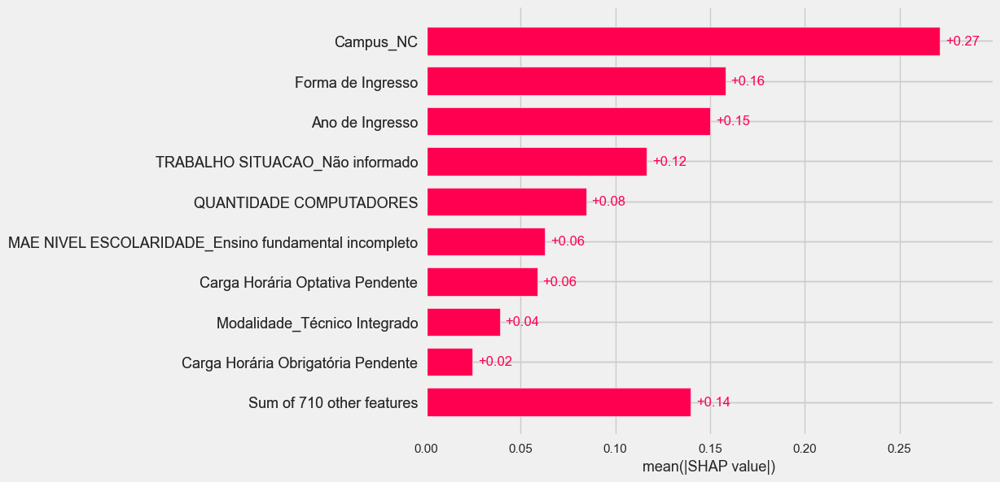

In [31]:
shap.plots.bar(shap_values)


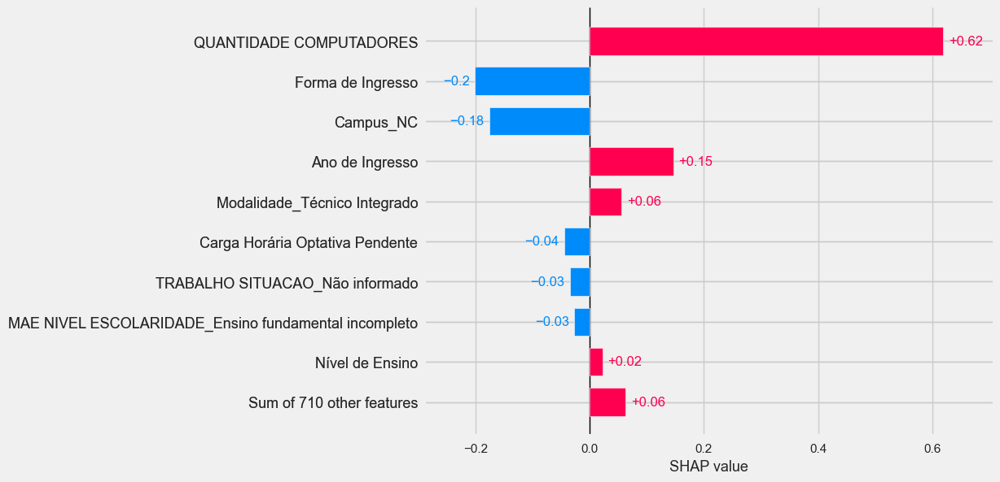

In [32]:
shap.plots.bar(shap_values[7])


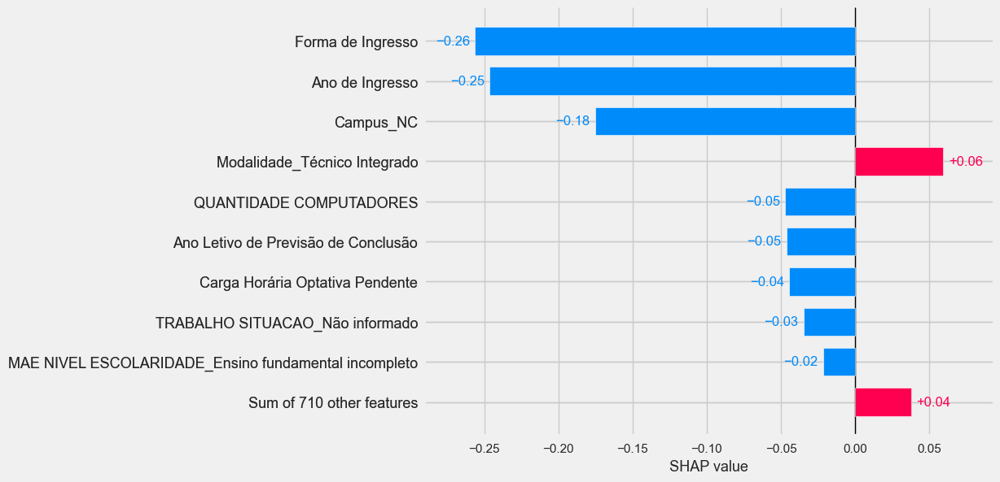

In [33]:
shap.plots.bar(shap_values[6])


Feature Importance do Modelo (LGBMClassifier)


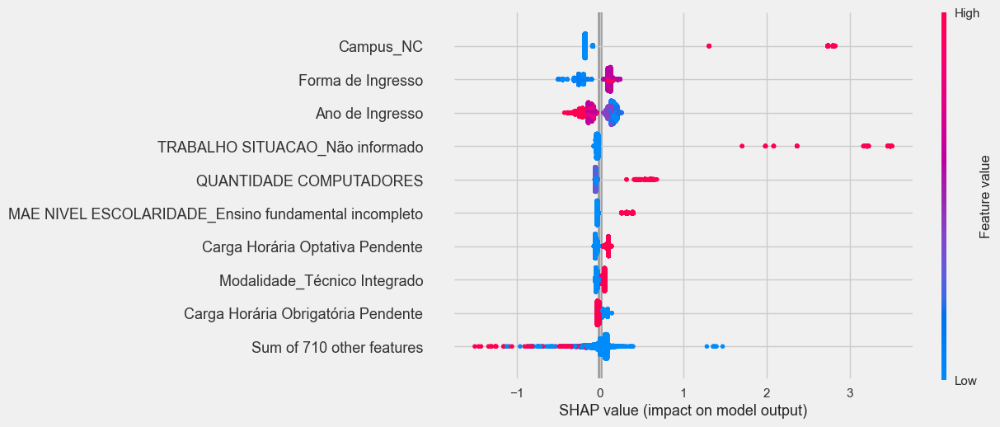

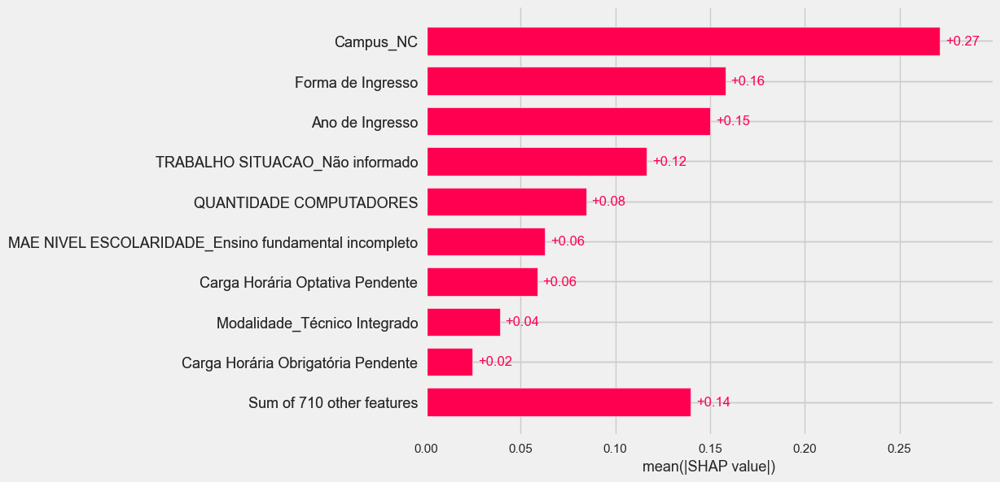

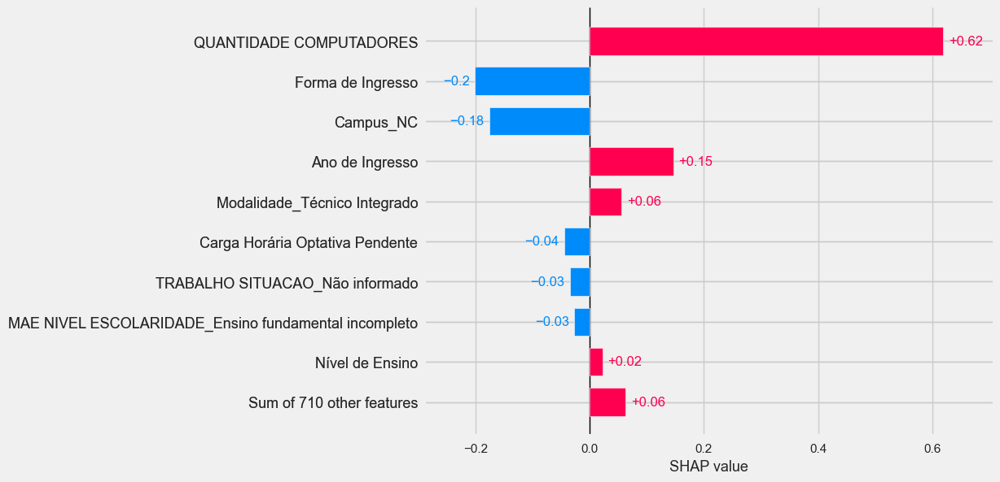

 99%|===================| 9265/9339 [02:00<00:00]        

Feature Importance do Modelo (CatBoostClassifier)


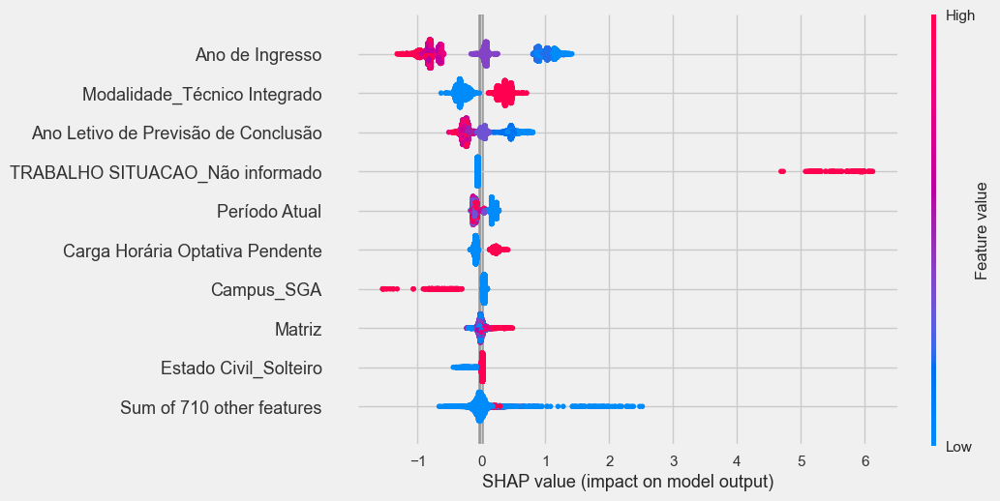

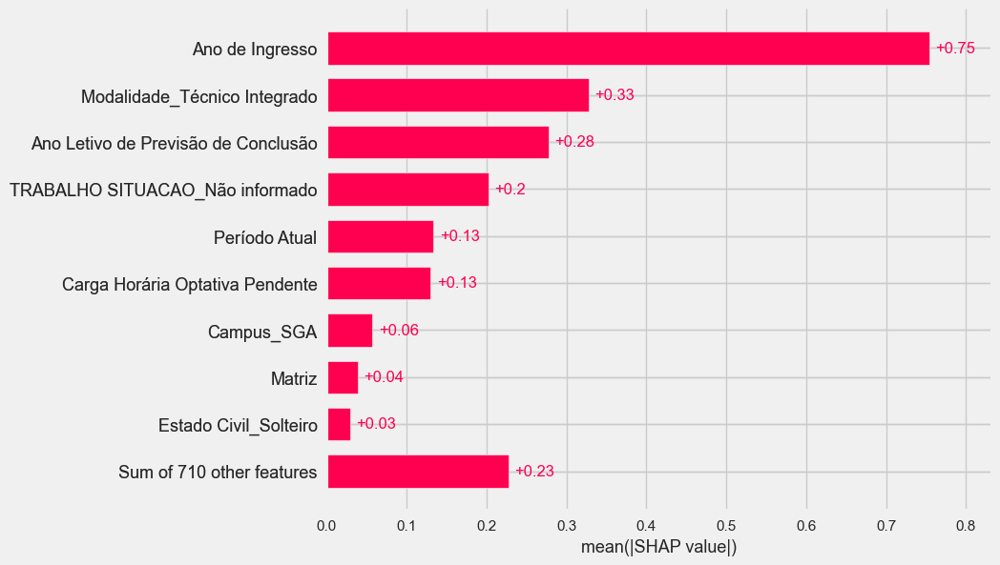

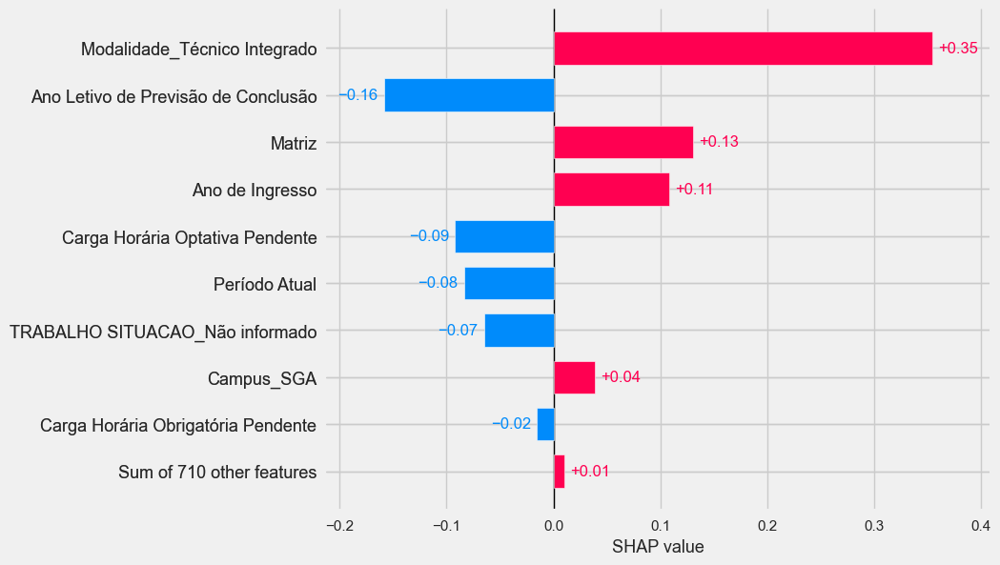

Feature Importance do Modelo (XGBClassifier)


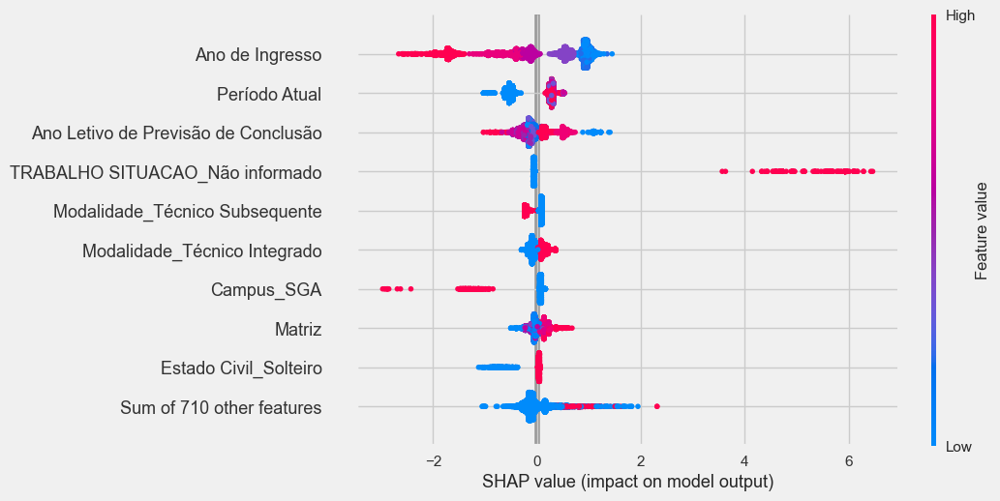

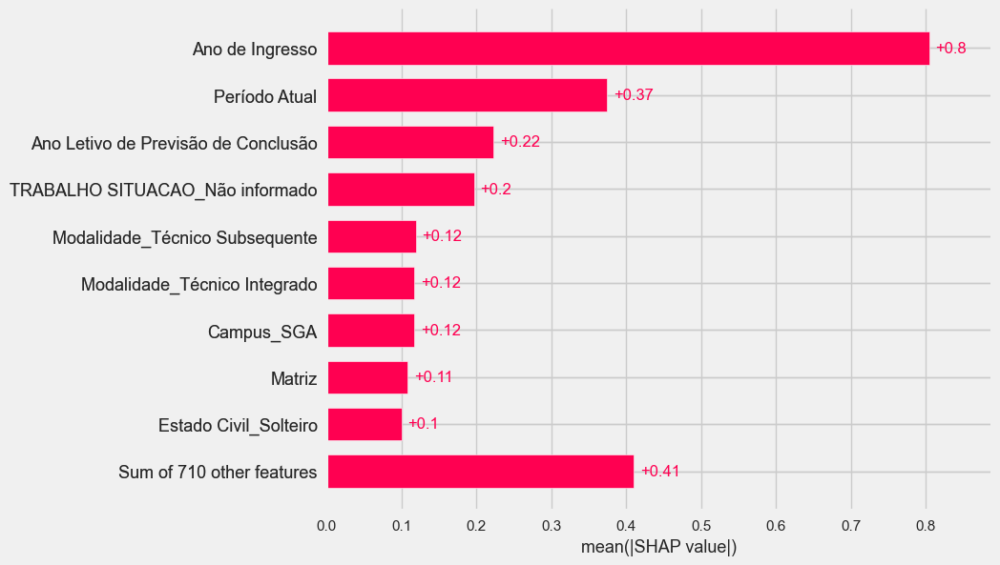

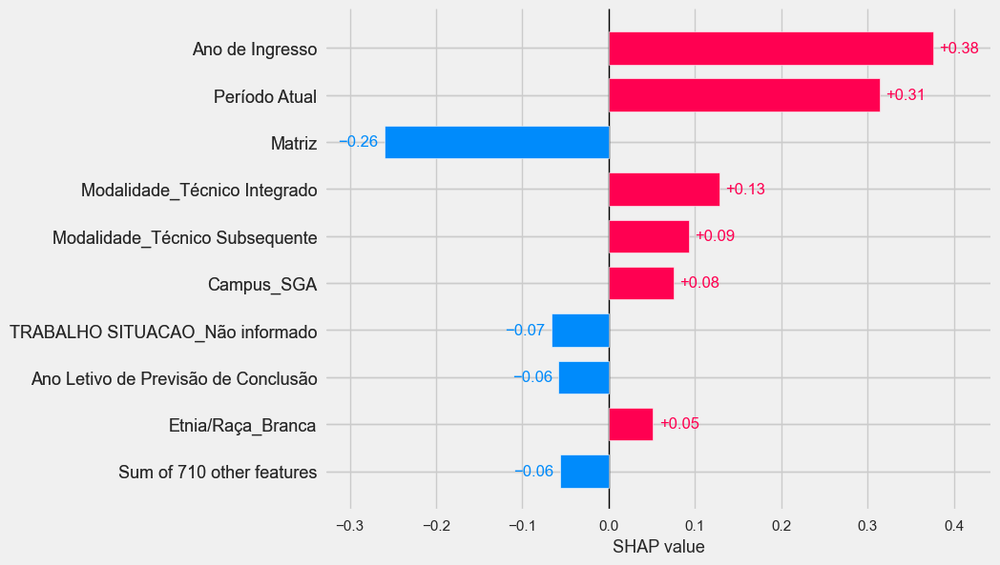

Feature Importance do Modelo (GradientBoostingClassifier)


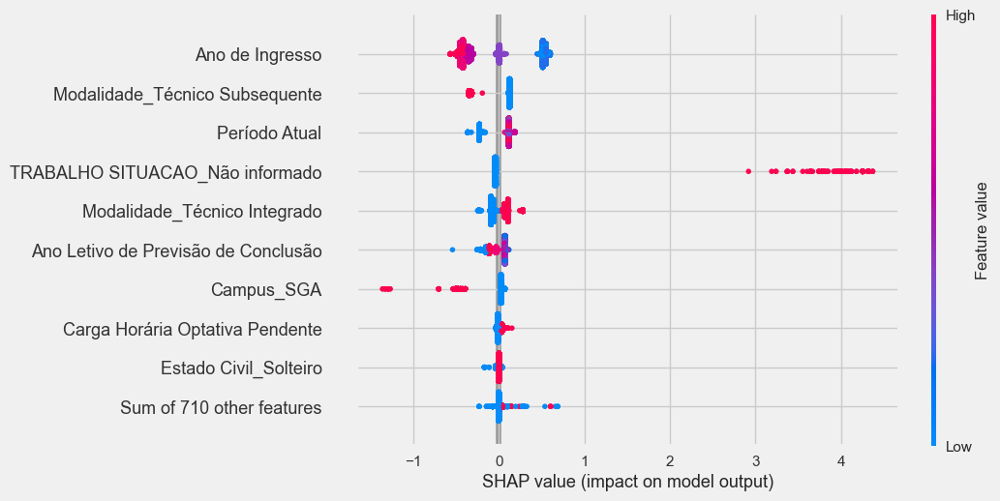

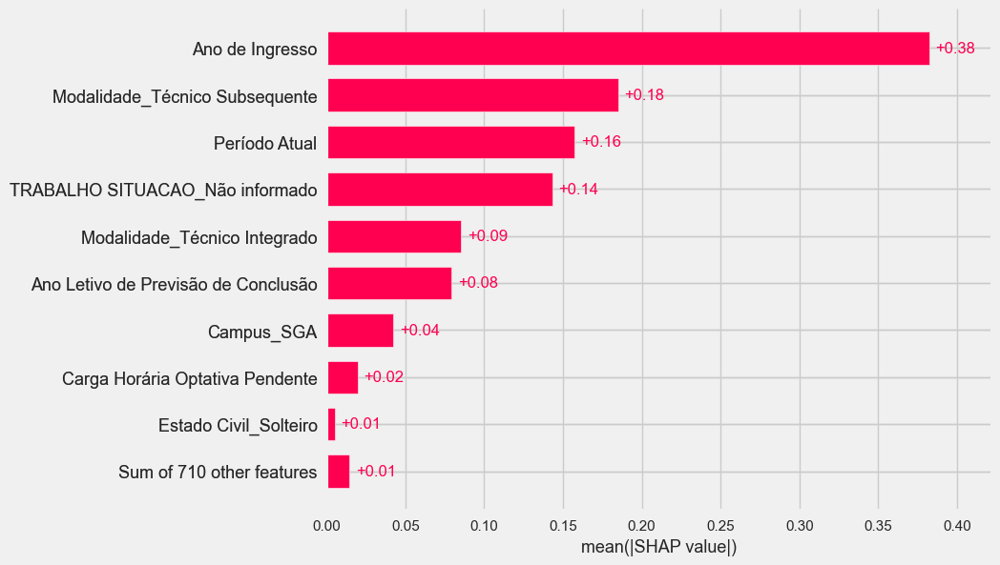

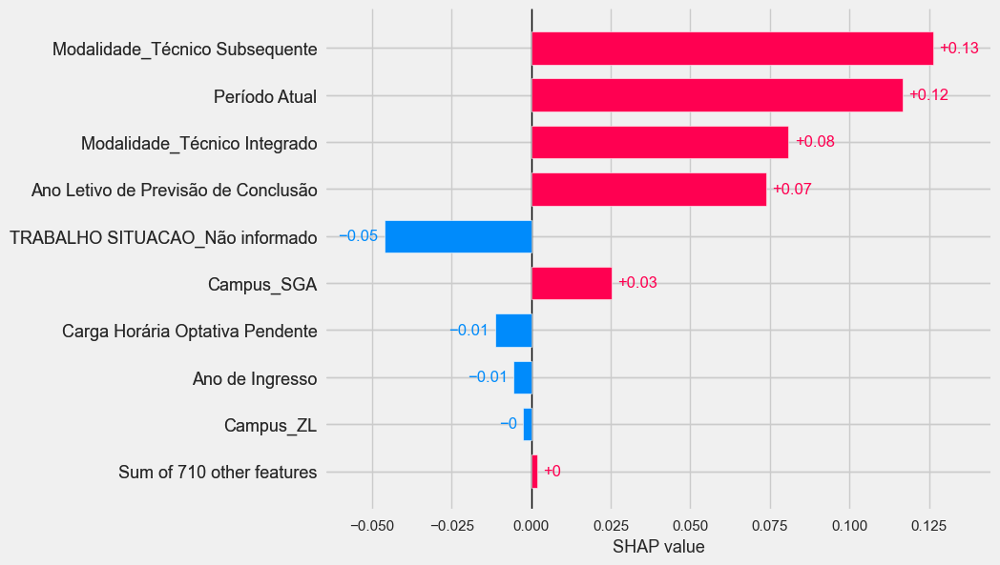

In [34]:
for model in tuned_top5:
    if model.__class__.__name__ in ('RandomForestClassifier', 'LinearDiscriminantAnalysis'):
        continue
    else:
        explainer = shap.Explainer(model, train_pipe) 
        shap_values = explainer(test_pipe) 

        print(f"Feature Importance do Modelo ({model.__class__.__name__})")
        shap.plots.beeswarm(shap_values)
        shap.plots.bar(shap_values)
        shap.plots.bar(shap_values[7])

